## Clustering as a startup company description.
The data that I need has been collected. I'll clustering the domain of the startup with the data I've collected.

In [317]:
import pandas as pd
import re
import string
import nltk
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
rc('font', family='AppleGothic')

Loading BokehJS ...

In [562]:
startup = pd.read_csv('description_euckr.csv')

In [563]:
startup.shape

(5653, 3)

In [564]:
#clean the data. 
def clear_sentence(data):
    data = re.sub('https://.*', '', data)
    data = re.sub('http://.*', '', data)
    data = re.sub('www://.*', '', data)
    data = data.replace('.', '. ')
    data = re.sub('['+string.punctuation+']', '', data)
    data = data.replace('\xa0', '')
    data = data.replace('‘', '')
    data = data.replace('’', '')
    data = data.replace('(주)', '')
    data = data.replace('㈜', '')
    data = data.replace('보도자료', '')

    return data

In [566]:
startup['clear_description'] = startup['description'].apply(clear_sentence)

In [567]:
startup.head()

,url,company,description,clear_description
0,/companies/soundgym,사운드짐,사운드짐은 빠르게 성장하고 있는 모바일 피트니스 시장에서 오디오 기반의 피트니스서비...,사운드짐은 빠르게 성장하고 있는 모바일 피트니스 시장에서 오디오 기반의 피트니스서비...
1,/companies/thevita,더비타,더비타는 블록체인 기반 라이프케어 회사입니다.건강에 필요한 좋은 습관을 통해 개인이...,더비타는 블록체인 기반 라이프케어 회사입니다 건강에 필요한 좋은 습관을 통해 개인이...
2,/companies/searp,포씨아,온디맨드 콘텐츠 미디어 플랫폼디지털 콘텐츠 거래 시장 시스템의 올바른 정착을 위한 ...,온디맨드 콘텐츠 미디어 플랫폼디지털 콘텐츠 거래 시장 시스템의 올바른 정착을 위한 ...
3,/companies/jusighoesa-maipateuneoseugeurub,주식회사 마이파트너스그룹,"마이파트너스그룹은 다양한 연예매니지먼트사와 연예인IP를 활용해 음악, 영화, 콘텐츠...",마이파트너스그룹은 다양한 연예매니지먼트사와 연예인IP를 활용해 음악 영화 콘텐츠 여...
4,/companies/seeso,시소,"아웃소싱을 넘어서, 미래의 ‘일’을 만듭니다. 회사가 아니어도 ‘일’을 할 수 있는...",아웃소싱을 넘어서 미래의 일을 만듭니다 회사가 아니어도 일을 할 수 있는 RUFR...


In [843]:
#remove stop words.
stop_words = pd.read_csv('stop_words_v1.1.csv')

In [844]:
stop_words.tail()

,stop_words
12478,누적
12479,공동
12480,본인
12481,등록
12482,인력


In [845]:
stop_words_list = []
for word in stop_words['stop_words']:
    stop_words_list.append(word)

In [846]:
# total count of stop words.
len(stop_words_list)

12483

In [847]:
# tokenizing
from konlpy.tag import Okt
from konlpy.tag import Mecab
m = Mecab()

In [828]:
# I will use token if token is noun.
# The reason why I only used nouns is because nouns are sufficiently classifiable.
def tokenizer_mecab_nouns(text):
    temp = m.nouns(text)
    result = []
    for a in temp:
        if a not in stop_words_list:
            result.append(a)
    result = [" ".join(result)]
    return result

In [848]:
# tokenizing!
startup['corpus'] = startup['clear_description'].apply(tokenizer_mecab_nouns)

In [ ]:
# list of string
corpus = [ t for d in startup['corpus'] for t in d]

## clustering.
I will use the kmeans to sort out the topics of the detailed description of the start-up.
Consine similarity is required for document clustering, 
but the kmeans in scikit-learn only use Euclidean resistance. L2 normalize attempted to resolve this issue.


In [851]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.preprocessing import normalize
from sklearn.cluster import KMeans

# vectorizing
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(corpus)

# L2 normalizing
X = normalize(X, norm='l2')

In [836]:
# Determines the number of clusters.
# I used  elbow method and silhouette score.
km_scores = []
km_silhouette = []
for i in range(2,31):
    km = KMeans(n_clusters=i, init='k-means++',n_init=10, max_iter=100,tol=1e-04, random_state=0).fit(X)
    preds = km.predict(X)
    
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X)))
    km_scores.append(-km.score(X))
    
    silhouette = silhouette_score(X,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    print("-"*100)

Score for number of cluster(s) 2: -5264.653760623263
Silhouette score for number of cluster(s) 2: 0.022405961741124
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -5208.8701709287625
Silhouette score for number of cluster(s) 3: 0.02490785062806196
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -5155.340025738616
Silhouette score for number of cluster(s) 4: 0.0262581014477741
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -5113.320171110164
Silhouette score for number of cluster(s) 5: 0.028440639452265038
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 6: -5074.829152094452
Silhouette score for number of cluster(s) 6: 0.030137383105919763
------

/Users/hanbyeol/anaconda3/envs/text/lib/python3.6/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/hanbyeol/anaconda3/envs/text/lib/python3.6/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


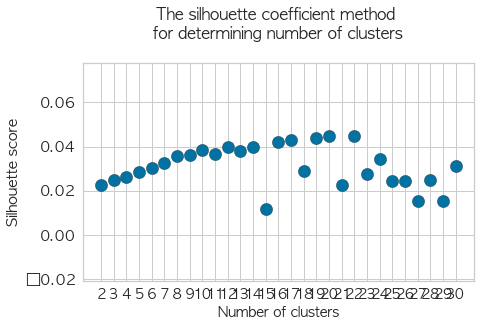

In [859]:
#silhouette 
plt.figure(figsize=(7,4))
plt.title("The silhouette coefficient method \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2,31)],y=km_silhouette,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Silhouette score",fontsize=15)
plt.xticks([i for i in range(2,31)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

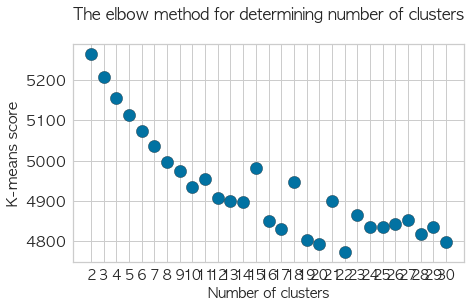

In [860]:
# elbow method
plt.figure(figsize=(7,4))
plt.title("The elbow method for determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2,31)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("K-means score",fontsize=15)
plt.xticks([i for i in range(2,31)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [861]:
# I've decided the number of clusters to 14.
n_cluster = 14

In [862]:
# I used this library for clustring docs.
# Soyclustering provides the spiral k-means algorithm for document clustering and the centroid-based cluster labelling algorithm.
# https://github.com/lovit/clustering4docs

from soyclustering import SphericalKMeans
# spherical k-means
spherical_kmeans = SphericalKMeans(n_clusters=n_cluster, max_iter=100, verbose=1, random_state=0, init='similar_cut')
X = normalize(X, norm='l2')
labels = spherical_kmeans.fit_predict(X)

initialization_time=0.021669 sec, sparsity=0.00197
n_iter=1, changed=4117, inertia=5240.760, iter_time=0.146 sec, sparsity=0.31
n_iter=2, changed=1828, inertia=4605.013, iter_time=0.103 sec, sparsity=0.314
n_iter=3, changed=1315, inertia=4403.996, iter_time=0.106 sec, sparsity=0.324
n_iter=4, changed=711, inertia=4336.076, iter_time=0.095 sec, sparsity=0.328
n_iter=5, changed=487, inertia=4309.193, iter_time=0.104 sec, sparsity=0.328
n_iter=6, changed=332, inertia=4293.685, iter_time=0.112 sec, sparsity=0.328
n_iter=7, changed=230, inertia=4284.444, iter_time=0.115 sec, sparsity=0.326
n_iter=8, changed=146, inertia=4278.191, iter_time=0.101 sec, sparsity=0.326
n_iter=9, changed=135, inertia=4272.739, iter_time=0.094 sec, sparsity=0.325
n_iter=10, changed=132, inertia=4267.437, iter_time=0.111 sec, sparsity=0.323
n_iter=11, changed=100, inertia=4261.200, iter_time=0.094 sec, sparsity=0.323
n_iter=12, changed=72, inertia=4257.651, iter_time=0.093 sec, sparsity=0.322
n_iter=13, changed=47

In [863]:
from soyclustering import proportion_keywords

vocabs = [vocab for vocab, idx in sorted(vectorizer.vocabulary_.items(), key=lambda x:x[1])]
centers = spherical_kmeans.cluster_centers_

keywords = proportion_keywords(
    centers,
    labels=labels,
    index2word=vocabs)

In [864]:
# Let's visualize the results with pyldavis.
# https://github.com/lovit/kmeans_to_pyLDAvis
# This library uses pyLDAvis to visualize the results of document clustering learning using (Spirical) k-means.

import kmeans_to_pyLDAvis
from kmeans_to_pyLDAvis import kmeans_to_prepared_data

vocab2int = vectorizer.vocabulary_
int2vocab = [
    word for word, index in sorted(
        vocab2int.items(), key=lambda x: x[1])
]
prepared_data = kmeans_to_prepared_data(
    X, int2vocab, centers, labels,
    embedding_method='tsne'
)

In [877]:
# The classified results are reasonable.
# Words similar to the domain were categorized.
htmlFile = 'kmeans_pyLDAvis.html'
pyLDAvis.save_html(prepared_data, htmlFile)
pyLDAvis.display(prepared_data)

In [866]:
#print top terms per cluster.
print("Top terms per cluster:")
order_centroids = centers.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()
for i in range(n_cluster):
    print("Cluster %d:" % i),
    for ind in order_centroids[i, :10]:
        print(' %s' % terms[ind]),
    print

print("\n")
print("Prediction")

Top terms per cluster:
Cluster 0:
 게임
 스포츠
 엔터테인먼트
 스튜디오
 플레이
 블록체인
 즐거움
 퍼블리셔
 일본
 영화
Cluster 1:
 데이터
 분석
 빅데이터
 인공지능
 클라우드
 머신러닝
 실시간
 음성
 전략
 알고리즘
Cluster 2:
 블록체인
 커뮤니티
 암호화폐
 거래소
 금융
 토큰
 생태
 코인
 화폐
 혁명
Cluster 3:
 금융
 부동산
 투자자
 보험
 대출
 은행
 자산
 데이터
 분석
 중개
Cluster 4:
 음악
 중국
 마켓
 예술
 재능
 아티스트
 엔터테인먼트
 작품
 작가
 웹툰
Cluster 5:
 건강
 의료
 반려동물
 헬스케어
 병원
 경제
 사랑
 스포츠
 식품
 운동
Cluster 6:
 인테리어
 설계
 작업
 건축
 건설
 단순
 관계
 외주
 가구
 공사
Cluster 7:
 브랜드
 화장품
 패션
 마케팅
 중국
 오프라인
 뷰티
 스타일
 라이프
 수출
Cluster 8:
 여행
 예약
 외국인
 여행자
 투어
 호텔
 현지
 여행객
 여행사
 숙박
Cluster 9:
 광고
 영상
 동영상
 마케팅
 방송
 광고주
 매체
 홍보
 대행
 효과
Cluster 10:
 보안
 자동차
 전자
 차량
 클라우드
 적용
 하드웨어
 검증
 추진
 일본
Cluster 11:
 커머스
 패션
 쇼핑
 스타일
 라이프
 쇼핑몰
 가격
 오프라인
 배송
 즐거움
Cluster 12:
 마케팅
 광고
 전략
 브랜드
 분석
 커머스
 인플루언서
 홍보
 데이터
 중국
Cluster 13:
 교육
 학습
 아이
 영어
 학생
 놀이
 학교
 러닝
 공부
 대학


Prediction


In [908]:
startup['class'] = labels

In [925]:
# I put a text name on the label which is a number.
startup['class_kor'] = labels

In [935]:
cluster_dict = {
0 : '게임 & 엔터테인먼트',
1 : 'AI',
2 : '블록체인',
3 : '핀테크',
4 : '음악 & 웹툰 콘텐츠',
5 : '헬스케어',
6 : '인테리어',
7 : '뷰티',
8 : '여행',
9 : '광고 대행사',
10 : '자동차 관련',
11 : '온라인 커머스',
12 : '인플루언서 마케팅',
13 : '교육 & 학습'
}

In [936]:
startup = startup.replace({'class_kor': cluster_dict})

In [953]:
# Bucket Place is a Korean startup related to interior design. Classes have been well classified as interiors.
startup[startup['company'] =='버킷플레이스'][['company', 'clear_description','class_kor']]

,company,clear_description,class_kor
3778,버킷플레이스,버킷플레이스는 누구나 예쁜 집에 살 수 있어라는 미션과 함께 인테리어 정보 커머스 ...,인테리어


In [977]:
# Start-up companies classified as interior classes. There are a lot of companies that are related to interior,
# but there are some that are not.
startup[startup['class'] ==6][['company', 'clear_description']]

,company,clear_description
9,인테리어젠틀맨,상업공간만을 위한 인테리어 중개플랫폼인테리어젠틀맨입니다 인젠맨은 다양한 사람이 모여...
12,집닥,대한민국 인테리어 1등 간편안심 인테리어 집닥집닥은 인테리어를 필요로 하는 고객에게...
30,CABOOKS(씨에이북스),About CABOOKSSINCE 1998 사람과 사물과 자연의 원형 속에서 피어나...
70,와이제이에스브이,SAVE TIME SAVE MONEY 외식산업은 끈임없이 성장하고 있습니다 성장하...
75,에이팀벤처스,ATEAM VENTURES“오프라인에 머물던 제조를 온라인으로 연결하는 혁신적인 서...
...,...,...
5577,스페이스레븐,인테리어 O2O 서비스 NO 1 인포테리어 인테리어의 시작 인포테리어로 끝내다 인포...
5593,디자인디노이,디자인디노이 DESIGNDINOI상공간업무공간주거공간 What이 아닌 How...
5609,㈜ 아이지오스캔,소개 건설 및 인테리어 등의 공간정보 데이터를 측정하고 처리하는 스마트 측량 제품을...
5630,플라토,안녕하세요 지인들간의 편리한 소통을 제공하는 Facebook과 같은 SNS를 준비하...


In [903]:
# let's try to visualize the unit of documentation.
# Let's first reduce the dimension to tsne and then visualize it.
from sklearn.manifold import TSNE
tnse = TSNE(random_state=42,n_components=2, metric='cosine')#, learning_rate = 200)
tnse_model = tnse.fit_transform(X.toarray())

In [904]:
startup['X'] = tsne_features[:, 0]
startup['Y'] = tsne_features[:, 1]

In [924]:
startup.head()

,url,company,description,clear_description,corpus,class,X,Y,class_kor
0,/companies/soundgym,사운드짐,사운드짐은 빠르게 성장하고 있는 모바일 피트니스 시장에서 오디오 기반의 피트니스서비...,사운드짐은 빠르게 성장하고 있는 모바일 피트니스 시장에서 오디오 기반의 피트니스서비...,[피트니스 오디오 피트니스 운동 제안 건강 행동 실천 오디오 운동 효과 제약 건강 ...,5,-45.222057,-30.752357,헬스케어
1,/companies/thevita,더비타,더비타는 블록체인 기반 라이프케어 회사입니다.건강에 필요한 좋은 습관을 통해 개인이...,더비타는 블록체인 기반 라이프케어 회사입니다 건강에 필요한 좋은 습관을 통해 개인이...,[블록체인 라이프케어 건강 습관 삶 주도 라이프 데이터 블록체인 데이터 주권 궁극 ...,1,-19.890774,-14.022263,AI
2,/companies/searp,포씨아,온디맨드 콘텐츠 미디어 플랫폼디지털 콘텐츠 거래 시장 시스템의 올바른 정착을 위한 ...,온디맨드 콘텐츠 미디어 플랫폼디지털 콘텐츠 거래 시장 시스템의 올바른 정착을 위한 ...,[온디맨드 정착 이미지 저작 보호 적용 투명 운용 작가 일반 창작자 여자 1인 창작...,4,15.858686,21.318439,음악 & 웹툰 콘텐츠
3,/companies/jusighoesa-maipateuneoseugeurub,주식회사 마이파트너스그룹,"마이파트너스그룹은 다양한 연예매니지먼트사와 연예인IP를 활용해 음악, 영화, 콘텐츠...",마이파트너스그룹은 다양한 연예매니지먼트사와 연예인IP를 활용해 음악 영화 콘텐츠 여...,[마이파트너스그룹 연예인 음악 영화 여행 커머스 엔터테인먼트 영위 파트너스 컴퍼니 ...,8,-26.581820,27.621193,여행
4,/companies/seeso,시소,"아웃소싱을 넘어서, 미래의 ‘일’을 만듭니다. 회사가 아니어도 ‘일’을 할 수 있는...",아웃소싱을 넘어서 미래의 일을 만듭니다 회사가 아니어도 일을 할 수 있는 RUFR...,[아웃소싱 커뮤니티 외부 아웃소싱],2,24.962254,-19.764021,블록체인


In [932]:
#make a plot 
from bokeh.io import show, output_notebook, push_notebook, output_file, save
from bokeh.plotting import figure
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.palettes import Category20b
from bokeh.transform import linear_cmap as LinearColorMapper

output_notebook()

# Make a source and a scatter plot  
source = ColumnDataSource(startup)


mapper = LinearColorMapper(field_name = 'class', palette=Category20b[20], low=startup['class'].min(), high=startup['class'].max())
    
plot = figure(x_axis_label = 'T-SNE 1',
              y_axis_label = 'T-SNE 2', 
              width = 1000, height = 1000, title='startup')

plot.circle(x = 'X', 
    y = 'Y', 
    source = source,
    #color = colors,
    color=mapper,
    size = 10, alpha = .8)

hover = HoverTool(tooltips = [('company', '@company'),
                              ('class', '@class_kor')])
plot.add_tools(hover)

show(plot)
output_file("./test.html",mode='inline')
save(plot)


Loading BokehJS ...

'/Users/hanbyeol/Desktop/TOY/startup topic modeling/test.html'